In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

# Imports
import numpy as np
import tensorflow as tf

tf.logging.set_verbosity(tf.logging.INFO)

# Our application logic will be added here
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import scipy.misc
import glob
import sys
import math
import tensorflow.contrib.slim as slim
import imageio
import re

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


In [2]:
# import sys
# !conda install --yes --prefix {sys.prefix} t

In [3]:
# Helper functions, DO NOT modify this
def get_img_array(path):
    """
    Given path of image, returns it's numpy array
    """
    return imageio.imread(path)

def get_files(folder):
    """
    Given path to folder, returns list of files in it
    """
    filenames = [file for file in glob.glob(folder+'*/*')]
    filenames.sort()
    return filenames

def get_label(filepath, label2id):
    """
    Files are assumed to be labeled as: /path/to/file/999_frog.png
    Returns label for a filepath
    """
    tokens = filepath.split('/')
    label = tokens[-1].split('_')[1][:-4]
    if label in label2id:
        return label2id[label]
    else:
        sys.exit("Invalid label: " + label)


# Functions to load data, DO NOT change these

def get_labels(folder, label2id):
    """
    Returns vector of labels extracted from filenames of all files in folder
    :param folder: path to data folder
    :param label2id: mapping of text labels to numeric ids. (Eg: automobile -> 0)
    """
    files = get_files(folder)
    y = []
    for f in files:
        y.append(get_label(f,label2id))
    return np.array(y)


def get_label_mapping(label_file):
    """
    Returns mappings of label to index and index to label
    The input file has list of labels, each on a separate line.
    """
    with open(label_file, 'r') as f:
        id2label = f.readlines()
        id2label = [l.strip() for l in id2label]
    label2id = {}
    count = 0
    for label in id2label:
        label2id[label] = count
        count += 1
    return id2label, label2id

def get_images(folder):
    """
    returns numpy array of all samples in folder
    each column is a sample resized to 30x30 and flattened
    """
    files = get_files(folder)
    images = []
    count = 0
    
    for f in files:
        count += 1
        if count % 10000 == 0:
            print("Loaded {}/{}".format(count,len(files)))
        img_arr = get_img_array(f)
        images.append(img_arr)
    
    if folder== "HW2_data/test" :
        return images, files
    return images

def get_train_data(data_root_path):
    """
    Return X and y
    """
    train_data_path = data_root_path + 'train'
    id2label, label2id = get_label_mapping(data_root_path+'labels.txt')
    print(label2id)
    X = get_images(train_data_path)
    y = get_labels(train_data_path, label2id)
    return X, y

#def save_predictions(filename, y):tX_test, y_test= test_x, None
    """
    Dumps y into .npy file
    """
#    np.save(filename, y)

In [4]:
# Load the data
data_root_path = 'HW2_data/'
X_train, y_train = get_train_data(data_root_path) # this may take a few minutes
X_test, test_imgnames = get_images(data_root_path + 'test')
print('Data loading done')

{'airplane': 0, 'automobile': 1, 'bird': 2, 'cat': 3, 'deer': 4, 'dog': 5, 'frog': 6, 'horse': 7, 'ship': 8, 'truck': 9}
Loaded 10000/45000
Loaded 20000/45000
Loaded 30000/45000
Loaded 40000/45000
Data loading done


In [5]:
# convert all lists into numpy arrays

train_x= np.array(X_train)   # shape (50000,32,32,3)
train_y= np.array(y_train)   # shape (50000,1)
test_x= np.array(X_test)     # shape (10000, 32, 32,3)

# get minibatch

def get_batch(X, y, batch_size):

        idx = np.random.choice(X.shape[0], batch_size, replace=True)
        X_batch = X[idx]
        y_batch = y[idx]

        return X_batch, y_batch
    
    
# Invoke the above function to get our data.
X_train, y_train, X_val, y_val =train_x[:44000] ,train_y[:44000] , train_x[44000:], train_y[44000:]
print('Train data shape: ', X_train.shape)
print('Train labels shape: ', y_train.shape)
print('Validation data shape: ', X_val.shape)
print('Validation labels shape: ', y_val.shape)
print('Test data shape: ', test_x.shape)
# print('Test labels shape: ', y_test.shape)

Train data shape:  (44000, 32, 32, 3)
Train labels shape:  (44000,)
Validation data shape:  (1000, 32, 32, 3)
Validation labels shape:  (1000,)
Test data shape:  (5000, 32, 32, 3)


In [6]:
"""Implemented a Residual Network introduced by He et al"""

def normal_residual_unit(input_layer, is_training, filters,
                         kernel_size, initializer, num_unit):
    with tf.variable_scope('Residual_unit_%d' % num_unit):
        first_batch = tf.layers.batch_normalization(input_layer, training=is_training,
                                                    name='First_batchnorm')
        first_relu = tf.nn.relu(first_batch, name='First_relu')
        first_conv = tf.layers.conv2d(first_relu, filters, kernel_size, padding='same', 
                                      activation=None, kernel_initializer=initializer,
                                      name='First_convolution')
        sec_batch = tf.layers.batch_normalization(first_conv, training=is_training,
                                                  name='Second_batchnorm')
        sec_relu = tf.nn.relu(sec_batch, name='Second_relu')
        sec_conv = tf.layers.conv2d(sec_relu, filters, kernel_size, padding='same',
                                    activation=None, kernel_initializer=initializer,
                                    name='Second_convolution')        
        addition = input_layer+sec_conv
    return addition

def reshaped_residual_unit(input_layer, is_training, filters,
                           kernel_size, initializer, num_unit):

    with tf.variable_scope('Residual_unit_%d' % num_unit):
        first_batch = tf.layers.batch_normalization(input_layer, training=is_training,
                                                   name='First_batchnorm')
        first_relu = tf.nn.relu(first_batch, name='First_relu')
        first_conv = tf.layers.conv2d(first_relu, filters, kernel_size, strides=2,
                                      padding='same', activation=None, 
                                      kernel_initializer=initializer,
                                      name='First_convolution')
        sec_batch = tf.layers.batch_normalization(first_conv, training=is_training,
                                                  name='Second_batchnorm')
        sec_relu = tf.nn.relu(sec_batch, name='Second_relu')
        sec_conv = tf.layers.conv2d(sec_relu, filters, kernel_size, padding='same',
                                    activation=None, kernel_initializer=initializer,
                                    name='Second_convolution')        
        reshaped_inp = tf.layers.conv2d(input_layer, filters, 1, strides=2, 
                                       activation=None, kernel_initializer=initializer,
                                       name='Reshaped_input')
        addition = reshaped_inp+sec_conv
    return addition

def residual_block(input_layer, is_training, filters, kernel_size, 
                   num_units, num_block, initializer, reduce_size=True):
    res_units = {}
    with tf.variable_scope('Residual_block_%d' % num_block):
        if reduce_size:
            res_units[0] = reshaped_residual_unit(input_layer, is_training,
                filters, kernel_size, initializer, 0)
        else:
            res_units[0] = normal_residual_unit(input_layer, is_training,
                filters, kernel_size, initializer, 0)
        for i in range(1, num_units):
            res_units[i] = normal_residual_unit(res_units[i-1], is_training,
                filters, kernel_size, initializer, i)
    return res_units[num_units-1]

def my_model(X, y, is_training):
    
    initializer = tf.contrib.layers.xavier_initializer() #Xavier Initialization for the weights
    
    res_block = {} #Dictionary to keep record of the residual blocks
    
    filters = [32, 64, 128, 256, 512] #filters in each residual block
    
    # First convolution of the network
    first_conv = tf.layers.conv2d(X, 32, 3, padding='same', activation=None, 
                                  kernel_initializer=initializer,
                                  name='First_convolution')
    batchnorm_layer = tf.layers.batch_normalization(first_conv, training=is_training,
                                                   name='First_batchnorm')
    relu_layer = tf.nn.relu(batchnorm_layer, name='First_relu')
    
    for i in range(5):
        res_block[i] = residual_block(relu_layer, is_training, filters[i], 3, 5, i,
                                      initializer, reduce_size=False)
        if i!=4:
            strided_conv = tf.layers.conv2d(res_block[i], filters[i+1], 3, strides=2, 
                                            padding='same', activation=None, 
                                            kernel_initializer=initializer,
                                            name='Strided_convolution_%d' % i)
            batchnorm_strided = tf.layers.batch_normalization(strided_conv, 
                                                              training=is_training,
                                                              name='Batchnorm_strided_%d' % i)
            relu_layer = tf.nn.relu(batchnorm_strided, name='Relu_%d' % i)
    
    last_conv = tf.layers.conv2d(res_block[4], 10, 2, padding='valid', 
                                 activation=None, kernel_initializer=initializer,
                                 name='Last_convolution')
    last_batchnorm = tf.layers.batch_normalization(last_conv, training=is_training,
                                                   name='Last_batchnorm')
    preds = tf.reshape(last_batchnorm, [-1,10], name='Predictions')
    return preds
    
tf.reset_default_graph()

X = tf.placeholder(tf.float32, [None, 32, 32, 3])
y = tf.placeholder(tf.int64, [None])
is_training = tf.placeholder(tf.bool)


y_out = my_model(X,y,is_training)


mean_loss = tf.losses.softmax_cross_entropy(tf.one_hot(y, 10), y_out)
optimizer = tf.train.RMSPropOptimizer(1e-3)


# batch normalization
extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
with tf.control_dependencies(extra_update_ops):
    train_step = optimizer.minimize(mean_loss)

Training
0
Iteration 0: with minibatch training loss = 2.54 and accuracy of 0.11
Iteration 100: with minibatch training loss = 1.86 and accuracy of 0.3
Iteration 200: with minibatch training loss = 1.98 and accuracy of 0.31
Iteration 300: with minibatch training loss = 1.54 and accuracy of 0.49
Epoch 1, Overall loss = 1.85 and accuracy of 0.33


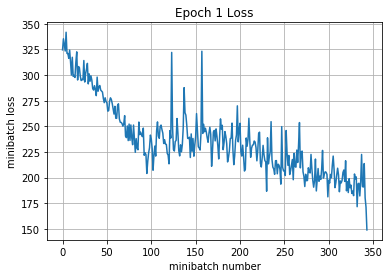

Validation
0
Epoch 1, Overall loss = 12.6 and accuracy of 0.265
Training
0
Iteration 0: with minibatch training loss = 1.53 and accuracy of 0.45
Iteration 100: with minibatch training loss = 1.46 and accuracy of 0.47
Iteration 200: with minibatch training loss = 1.31 and accuracy of 0.59
Iteration 300: with minibatch training loss = 1.09 and accuracy of 0.64
Epoch 1, Overall loss = 1.27 and accuracy of 0.563


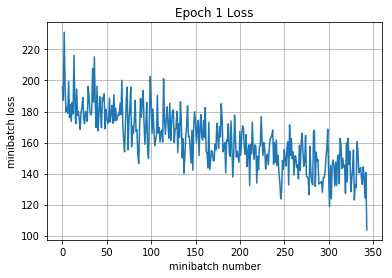

Validation
0
Epoch 1, Overall loss = 3.09 and accuracy of 0.361
Training
0
Iteration 0: with minibatch training loss = 1.26 and accuracy of 0.57
Iteration 100: with minibatch training loss = 0.986 and accuracy of 0.65
Iteration 200: with minibatch training loss = 0.796 and accuracy of 0.77
Iteration 300: with minibatch training loss = 0.803 and accuracy of 0.74
Epoch 1, Overall loss = 0.959 and accuracy of 0.675


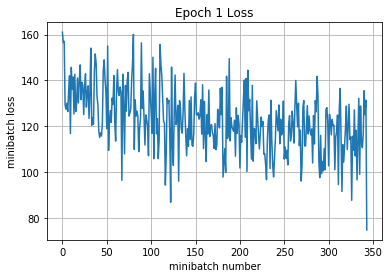

Validation
0
Epoch 1, Overall loss = 1.35 and accuracy of 0.57
Training
0
Iteration 0: with minibatch training loss = 0.861 and accuracy of 0.68
Iteration 100: with minibatch training loss = 0.83 and accuracy of 0.73
Iteration 200: with minibatch training loss = 0.815 and accuracy of 0.72
Iteration 300: with minibatch training loss = 0.662 and accuracy of 0.79
Epoch 1, Overall loss = 0.775 and accuracy of 0.745


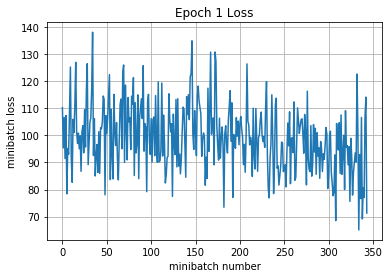

Validation
0
Epoch 1, Overall loss = 0.9 and accuracy of 0.691
Training
0
Iteration 0: with minibatch training loss = 0.625 and accuracy of 0.79
Iteration 100: with minibatch training loss = 0.705 and accuracy of 0.75
Iteration 200: with minibatch training loss = 0.7 and accuracy of 0.79
Iteration 300: with minibatch training loss = 0.642 and accuracy of 0.8
Epoch 1, Overall loss = 0.649 and accuracy of 0.789


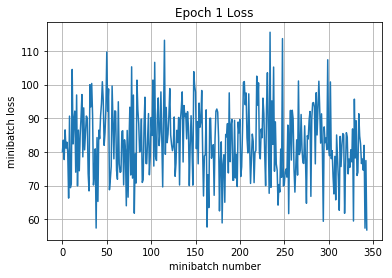

Validation
0
Epoch 1, Overall loss = 0.884 and accuracy of 0.713
Training
0
Iteration 0: with minibatch training loss = 0.593 and accuracy of 0.84
Iteration 100: with minibatch training loss = 0.619 and accuracy of 0.81
Iteration 200: with minibatch training loss = 0.574 and accuracy of 0.82
Iteration 300: with minibatch training loss = 0.567 and accuracy of 0.8
Epoch 1, Overall loss = 0.549 and accuracy of 0.82


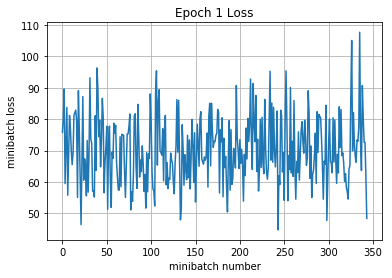

Validation
0
Epoch 1, Overall loss = 0.778 and accuracy of 0.732
Training
0
Iteration 0: with minibatch training loss = 0.375 and accuracy of 0.91
Iteration 100: with minibatch training loss = 0.524 and accuracy of 0.83
Iteration 200: with minibatch training loss = 0.606 and accuracy of 0.82
Iteration 300: with minibatch training loss = 0.503 and accuracy of 0.83
Epoch 1, Overall loss = 0.471 and accuracy of 0.848


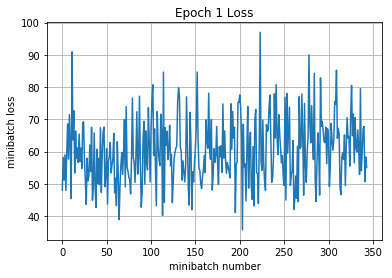

Validation
0
Epoch 1, Overall loss = 0.86 and accuracy of 0.73
Training
0
Iteration 0: with minibatch training loss = 0.409 and accuracy of 0.84
Iteration 100: with minibatch training loss = 0.362 and accuracy of 0.9
Iteration 200: with minibatch training loss = 0.39 and accuracy of 0.88
Iteration 300: with minibatch training loss = 0.343 and accuracy of 0.88
Epoch 1, Overall loss = 0.404 and accuracy of 0.869


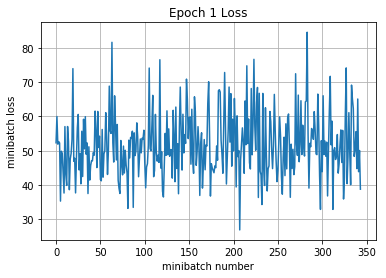

Validation
0
Epoch 1, Overall loss = 0.681 and accuracy of 0.793
Training
0
Iteration 0: with minibatch training loss = 0.244 and accuracy of 0.92
Iteration 100: with minibatch training loss = 0.399 and accuracy of 0.88
Iteration 200: with minibatch training loss = 0.305 and accuracy of 0.91
Iteration 300: with minibatch training loss = 0.32 and accuracy of 0.91
Epoch 1, Overall loss = 0.343 and accuracy of 0.891


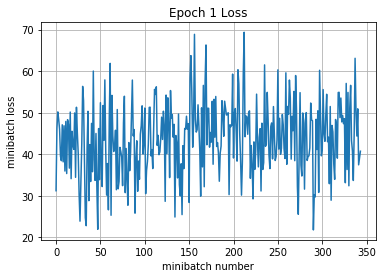

Validation
0
Epoch 1, Overall loss = 0.658 and accuracy of 0.794
Training
0
Iteration 0: with minibatch training loss = 0.216 and accuracy of 0.92
Iteration 100: with minibatch training loss = 0.276 and accuracy of 0.92
Iteration 200: with minibatch training loss = 0.375 and accuracy of 0.89
Iteration 300: with minibatch training loss = 0.298 and accuracy of 0.91
Epoch 1, Overall loss = 0.292 and accuracy of 0.907


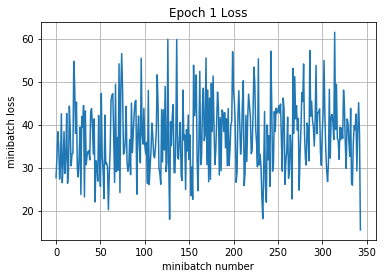

Validation
0
Epoch 1, Overall loss = 0.728 and accuracy of 0.77
Training
0
Iteration 0: with minibatch training loss = 0.215 and accuracy of 0.94
Iteration 100: with minibatch training loss = 0.217 and accuracy of 0.91
Iteration 200: with minibatch training loss = 0.308 and accuracy of 0.89
Iteration 300: with minibatch training loss = 0.243 and accuracy of 0.91
Epoch 1, Overall loss = 0.251 and accuracy of 0.921


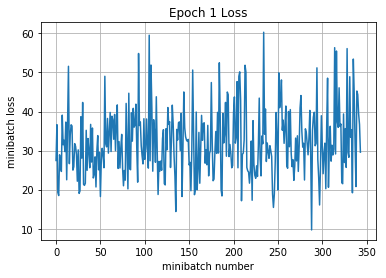

Validation
0
Epoch 1, Overall loss = 0.725 and accuracy of 0.791
Training
0
Iteration 0: with minibatch training loss = 0.105 and accuracy of 0.98
Iteration 100: with minibatch training loss = 0.242 and accuracy of 0.93
Iteration 200: with minibatch training loss = 0.282 and accuracy of 0.89
Iteration 300: with minibatch training loss = 0.345 and accuracy of 0.9
Epoch 1, Overall loss = 0.214 and accuracy of 0.93


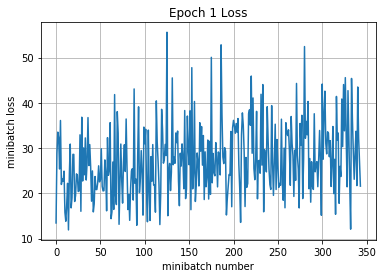

Validation
0
Epoch 1, Overall loss = 1.03 and accuracy of 0.716
Training
0
Iteration 0: with minibatch training loss = 0.203 and accuracy of 0.94
Iteration 100: with minibatch training loss = 0.217 and accuracy of 0.93
Iteration 200: with minibatch training loss = 0.146 and accuracy of 0.94
Iteration 300: with minibatch training loss = 0.256 and accuracy of 0.91
Epoch 1, Overall loss = 0.185 and accuracy of 0.941


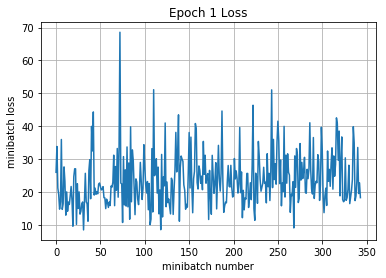

Validation
0
Epoch 1, Overall loss = 0.859 and accuracy of 0.766
Training
0
Iteration 0: with minibatch training loss = 0.142 and accuracy of 0.94
Iteration 100: with minibatch training loss = 0.0795 and accuracy of 0.98
Iteration 200: with minibatch training loss = 0.147 and accuracy of 0.94
Iteration 300: with minibatch training loss = 0.0555 and accuracy of 0.99
Epoch 1, Overall loss = 0.161 and accuracy of 0.95


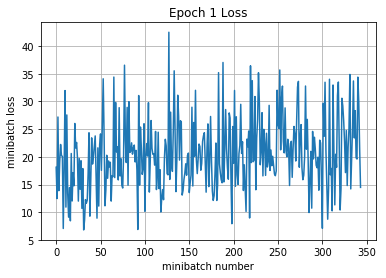

Validation
0
Epoch 1, Overall loss = 0.702 and accuracy of 0.801
Training
0
Iteration 0: with minibatch training loss = 0.209 and accuracy of 0.93
Iteration 100: with minibatch training loss = 0.153 and accuracy of 0.96
Iteration 200: with minibatch training loss = 0.223 and accuracy of 0.94
Iteration 300: with minibatch training loss = 0.131 and accuracy of 0.95
Epoch 1, Overall loss = 0.139 and accuracy of 0.957


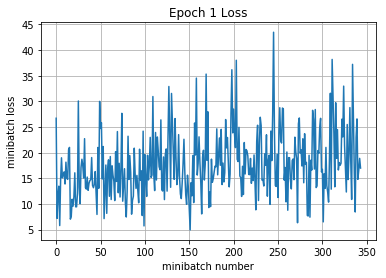

Validation
0
Epoch 1, Overall loss = 0.853 and accuracy of 0.787
Training
0
Iteration 0: with minibatch training loss = 0.0901 and accuracy of 0.97
Iteration 100: with minibatch training loss = 0.175 and accuracy of 0.93
Iteration 200: with minibatch training loss = 0.0592 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.0683 and accuracy of 0.98
Epoch 1, Overall loss = 0.13 and accuracy of 0.959


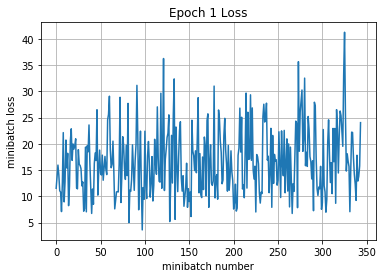

Validation
0
Epoch 1, Overall loss = 0.806 and accuracy of 0.789
Training
0
Iteration 0: with minibatch training loss = 0.0359 and accuracy of 0.99
Iteration 100: with minibatch training loss = 0.137 and accuracy of 0.96
Iteration 200: with minibatch training loss = 0.0292 and accuracy of 0.99
Iteration 300: with minibatch training loss = 0.209 and accuracy of 0.93
Epoch 1, Overall loss = 0.112 and accuracy of 0.965


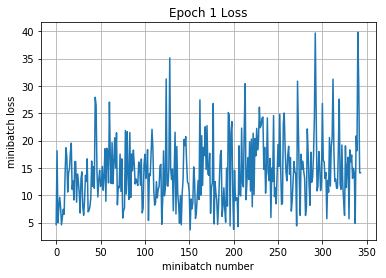

Validation
0
Epoch 1, Overall loss = 0.835 and accuracy of 0.796
Training
0
Iteration 0: with minibatch training loss = 0.157 and accuracy of 0.95
Iteration 100: with minibatch training loss = 0.0447 and accuracy of 0.98
Iteration 200: with minibatch training loss = 0.102 and accuracy of 0.96
Iteration 300: with minibatch training loss = 0.106 and accuracy of 0.96
Epoch 1, Overall loss = 0.0988 and accuracy of 0.969


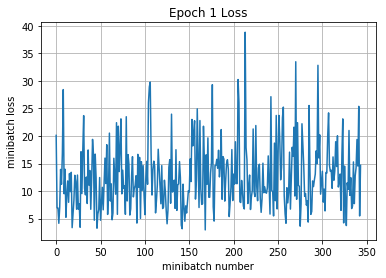

Validation
0
Epoch 1, Overall loss = 0.756 and accuracy of 0.81
Training
0
Iteration 0: with minibatch training loss = 0.153 and accuracy of 0.96
Iteration 100: with minibatch training loss = 0.0723 and accuracy of 0.97
Iteration 200: with minibatch training loss = 0.102 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.126 and accuracy of 0.95
Epoch 1, Overall loss = 0.0905 and accuracy of 0.971


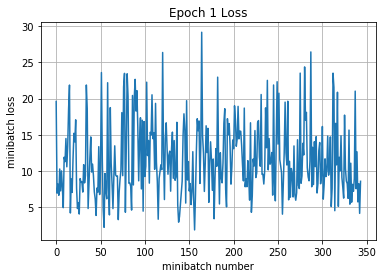

Validation
0
Epoch 1, Overall loss = 0.85 and accuracy of 0.801
Training
0
Iteration 0: with minibatch training loss = 0.104 and accuracy of 0.95
Iteration 100: with minibatch training loss = 0.0946 and accuracy of 0.97
Iteration 200: with minibatch training loss = 0.079 and accuracy of 0.97
Iteration 300: with minibatch training loss = 0.141 and accuracy of 0.96
Epoch 1, Overall loss = 0.0835 and accuracy of 0.974


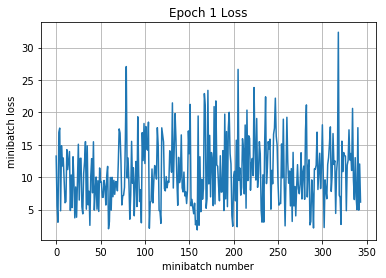

Validation
0
Epoch 1, Overall loss = 0.848 and accuracy of 0.788
Training
0
Iteration 0: with minibatch training loss = 0.0208 and accuracy of 1
Iteration 100: with minibatch training loss = 0.163 and accuracy of 0.95
Iteration 200: with minibatch training loss = 0.0651 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.0723 and accuracy of 0.98
Epoch 1, Overall loss = 0.0791 and accuracy of 0.975


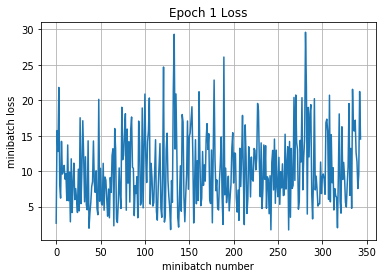

Validation
0
Epoch 1, Overall loss = 0.77 and accuracy of 0.814
Training
0
Iteration 0: with minibatch training loss = 0.0784 and accuracy of 0.98
Iteration 100: with minibatch training loss = 0.0692 and accuracy of 0.97
Iteration 200: with minibatch training loss = 0.0513 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.0338 and accuracy of 1
Epoch 1, Overall loss = 0.0727 and accuracy of 0.977


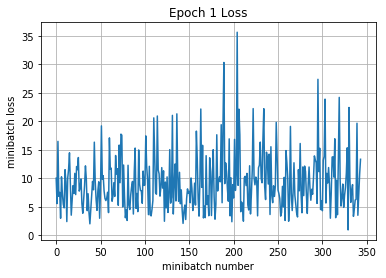

Validation
0
Epoch 1, Overall loss = 0.807 and accuracy of 0.812
Training
0
Iteration 0: with minibatch training loss = 0.0573 and accuracy of 0.99
Iteration 100: with minibatch training loss = 0.0645 and accuracy of 0.98
Iteration 200: with minibatch training loss = 0.106 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.103 and accuracy of 0.97
Epoch 1, Overall loss = 0.0676 and accuracy of 0.978


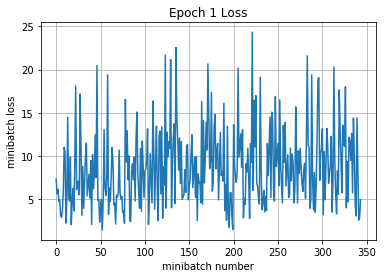

Validation
0
Epoch 1, Overall loss = 0.988 and accuracy of 0.78
Training
0
Iteration 0: with minibatch training loss = 0.0841 and accuracy of 0.97
Iteration 100: with minibatch training loss = 0.0542 and accuracy of 0.98
Iteration 200: with minibatch training loss = 0.0993 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.0333 and accuracy of 0.99
Epoch 1, Overall loss = 0.0642 and accuracy of 0.98


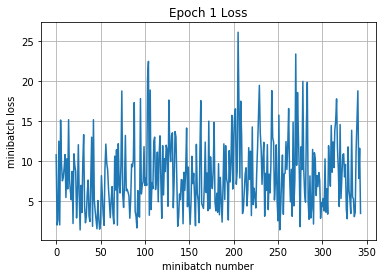

Validation
0
Epoch 1, Overall loss = 0.705 and accuracy of 0.836
Training
0
Iteration 0: with minibatch training loss = 0.0182 and accuracy of 1
Iteration 100: with minibatch training loss = 0.056 and accuracy of 0.99
Iteration 200: with minibatch training loss = 0.0672 and accuracy of 0.99
Iteration 300: with minibatch training loss = 0.0384 and accuracy of 0.99
Epoch 1, Overall loss = 0.0558 and accuracy of 0.982


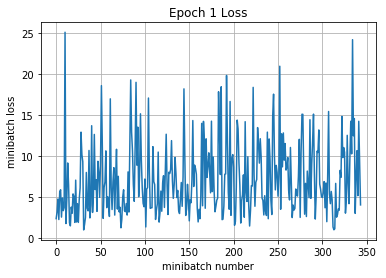

Validation
0
Epoch 1, Overall loss = 0.764 and accuracy of 0.831
Training
0
Iteration 0: with minibatch training loss = 0.0249 and accuracy of 0.99
Iteration 100: with minibatch training loss = 0.0684 and accuracy of 0.97
Iteration 200: with minibatch training loss = 0.0338 and accuracy of 1
Iteration 300: with minibatch training loss = 0.0874 and accuracy of 0.98
Epoch 1, Overall loss = 0.0558 and accuracy of 0.982


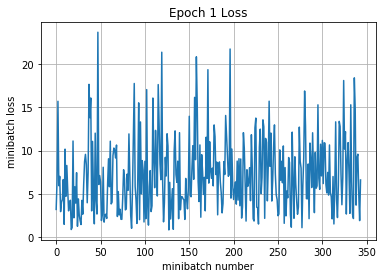

Validation
0
Epoch 1, Overall loss = 0.946 and accuracy of 0.797
Training
0
Iteration 0: with minibatch training loss = 0.0301 and accuracy of 0.98
Iteration 100: with minibatch training loss = 0.0214 and accuracy of 1
Iteration 200: with minibatch training loss = 0.0346 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.109 and accuracy of 0.96
Epoch 1, Overall loss = 0.0528 and accuracy of 0.984


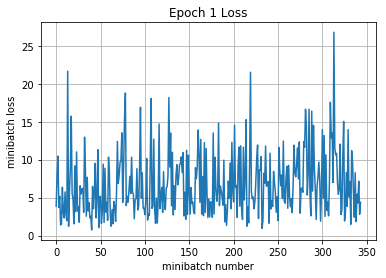

Validation
0
Epoch 1, Overall loss = 0.828 and accuracy of 0.81
Training
0
Iteration 0: with minibatch training loss = 0.0627 and accuracy of 0.98
Iteration 100: with minibatch training loss = 0.0427 and accuracy of 0.98
Iteration 200: with minibatch training loss = 0.00709 and accuracy of 1
Iteration 300: with minibatch training loss = 0.0153 and accuracy of 0.99
Epoch 1, Overall loss = 0.0467 and accuracy of 0.985


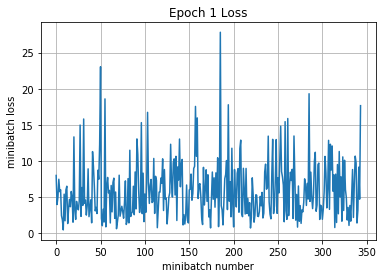

Validation
0
Epoch 1, Overall loss = 0.934 and accuracy of 0.792
Training
0
Iteration 0: with minibatch training loss = 0.0499 and accuracy of 0.98
Iteration 100: with minibatch training loss = 0.0583 and accuracy of 0.98
Iteration 200: with minibatch training loss = 0.0505 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.0111 and accuracy of 0.99
Epoch 1, Overall loss = 0.0479 and accuracy of 0.984


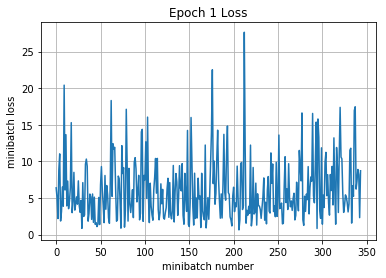

Validation
0
Epoch 1, Overall loss = 0.766 and accuracy of 0.828
Training
0
Iteration 0: with minibatch training loss = 0.0377 and accuracy of 0.99
Iteration 100: with minibatch training loss = 0.0087 and accuracy of 1
Iteration 200: with minibatch training loss = 0.0744 and accuracy of 0.98
Iteration 300: with minibatch training loss = 0.0858 and accuracy of 0.98
Epoch 1, Overall loss = 0.0453 and accuracy of 0.985


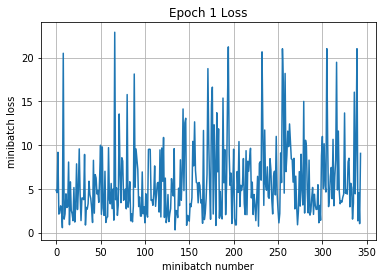

Validation
0
Epoch 1, Overall loss = 0.757 and accuracy of 0.838
testing
[[  1.59106934   2.15468788   1.50645113 ...,  12.34251308   0.908979
    0.73483866]
 [  1.69518626   1.59069514   1.63856852 ...,   1.66461766   1.42947531
    1.34930289]
 [  2.37054825  13.8448391    2.72685027 ...,   1.99226558   3.3106513
    0.59510356]
 ..., 
 [  1.32692409   0.43197688   3.22118211 ...,   1.97856557   2.86601949
   13.29037762]
 [ -0.58360976   0.13946615   9.70169926 ...,  -0.10859919  -1.01436353
   -0.64023244]
 [ -3.83551311  -3.65312052  -0.75440836 ...,  -2.10958052  -2.67279863
   -3.53691959]]


In [7]:
def run_model(session, predict, loss_val, Xd, yd, testing,
              epochs=1, batch_size=64, print_every=5,
              training=None, plot_losses=False, ):
    
    correct_prediction = tf.equal(tf.argmax(predict,1), y)
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
    
    
    train_indicies = np.arange(Xd.shape[0])
    np.random.shuffle(train_indicies)

    training_now = training is not None
    
    variables = [mean_loss,correct_prediction,accuracy]
    if training_now:
        variables[-1] = training
    
    
    
    
    
    if testing== 1:
        feed_dict = {X: Xd, y: yd,
                         is_training: training_now }
        y_o = session.run(y_out,feed_dict=feed_dict)
        print( y_o)
        return y_o
        
        
         
    iter_cnt = 0
    for e in range(epochs):
        print(e)
        correct = 0
        losses = []
        for i in range(int(math.ceil(Xd.shape[0]/batch_size))):
            
            start_idx = (i*batch_size)%Xd.shape[0]
            idx = train_indicies[start_idx:start_idx+batch_size]
            
            feed_dict = {X: Xd[idx,:],
                         y: yd[idx],
                         is_training: training_now}
            
            actual_batch_size = yd[idx].shape[0]
            
            loss, corr, _ = session.run(variables,feed_dict=feed_dict)
            
    
            losses.append(loss*actual_batch_size)
            correct += np.sum(corr)
            
            if training_now and (iter_cnt % print_every) == 0:
                print("Iteration {0}: with minibatch training loss = {1:.3g} and accuracy of {2:.2g}"\
                      .format(iter_cnt,loss,np.sum(corr)/actual_batch_size))
            iter_cnt += 1
        total_correct = correct/Xd.shape[0]
        total_loss = np.sum(losses)/Xd.shape[0]
        print("Epoch {2}, Overall loss = {0:.3g} and accuracy of {1:.3g}"\
              .format(total_loss,total_correct,e+1))
        if plot_losses:
            plt.plot(losses)
            plt.grid(True)
            plt.title('Epoch {} Loss'.format(e+1))
            plt.xlabel('minibatch number')
            plt.ylabel('minibatch loss')
            plt.show()
    return total_loss,total_correct

with tf.Session() as sess:
    with tf.device("/gpu:0"): #Used GPU to utilize AWS Deep Learning AMI 
        sess.run(tf.global_variables_initializer())
        for i in range(30):
            print('Training')
            run_model(sess,y_out,mean_loss,np.array(X_train),y_train,0,1
                      ,128,100,train_step,True)
            print('Validation')
            run_model(sess,y_out,mean_loss,np.array(X_val),y_val,0,1,128)
        print('testing')
        y= run_model(sess,y_out,mean_loss,np.array(X_test),y_val,1)

In [8]:
import pickle
pickling_on = open("result003.pickle","wb")
pickle.dump(np.argmax(y,axis=1), pickling_on)

In [9]:
def softmax(logits):
    ans = np.exp(logits) / np.sum(np.exp(logits))
    return ans
ysoft = []
for i in range(len(y)):
    ysoft.append(softmax(y[i]))
ysoft = np.array(ysoft)
y_soft = np.argmax(ysoft,axis=1)
ysoft[0]

array([  2.14110642e-05,   3.76196404e-05,   1.96738347e-05,
         2.61406167e-05,   1.44303494e-05,   3.37557913e-06,
         1.64953344e-05,   9.99841034e-01,   1.08245586e-05,
         9.09456594e-06], dtype=float32)

In [10]:
#test_imgnames
xs = []
for i in test_imgnames:
    lr = re.findall('\d+',i)
    xs.append(int(lr[1]))
xs = np.array(xs)
xs.shape


with open('result003.pickle', 'rb') as f:
    pre= pickle.load(f)
#pre.shape
my_dict = {}
for i in range(5000):
    my_dict[xs[i]] = pre[i]
n = {}
for key in sorted(my_dict):
    n[key] = my_dict[key]

y_fin = []
my_dict2 = {0:'airplane' , 1:'automobile', 2: 'bird', 3:'cat', 4: 'deer',5: 'dog', 6:'frog',7: 'horse',8: 'ship', 9:'truck'}
for i in n.values():
    y_fin.append(my_dict2[i])
with open('csvfile3.csv','w') as file:
    for label in y_fin:
        file.write(label)
        file.write('\n')

In [11]:
from IPython.display import clear_output, Image, display, HTML

def strip_consts(graph_def, max_const_size=32):
    """Strip large constant values from graph_def."""
    strip_def = tf.GraphDef()
    for n0 in graph_def.node:
        n = strip_def.node.add() 
        n.MergeFrom(n0)
        if n.op == 'Const':
            tensor = n.attr['value'].tensor
            size = len(tensor.tensor_content)
            if size > max_const_size:
                tensor.tensor_content = "<stripped %d bytes>"%size
    return strip_def

def show_graph(graph_def, max_const_size=32):
    """Visualize TensorFlow graph."""
    if hasattr(graph_def, 'as_graph_def'):
        graph_def = graph_def.as_graph_def()
    strip_def = strip_consts(graph_def, max_const_size=max_const_size)
    code = """
        <script>
          function load() {{
            document.getElementById("{id}").pbtxt = {data};
          }}
        </script>
        <link rel="import" href="https://tensorboard.appspot.com/tf-graph-basic.build.html" onload=load()>
        <div style="height:600px">
          <tf-graph-basic id="{id}"></tf-graph-basic>
        </div>
    """.format(data=repr(str(strip_def)), id='graph'+str(np.random.rand()))

    iframe = """
        <iframe seamless style="width:1200px;height:620px;border:0" srcdoc="{}"></iframe>
    """.format(code.replace('"', '&quot;'))
    display(HTML(iframe))

In [12]:
show_graph(tf.get_default_graph().as_graph_def())